Skipping malformed line (invalid numbers): 2brlA02	56-132,164-187,229-262,279-                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

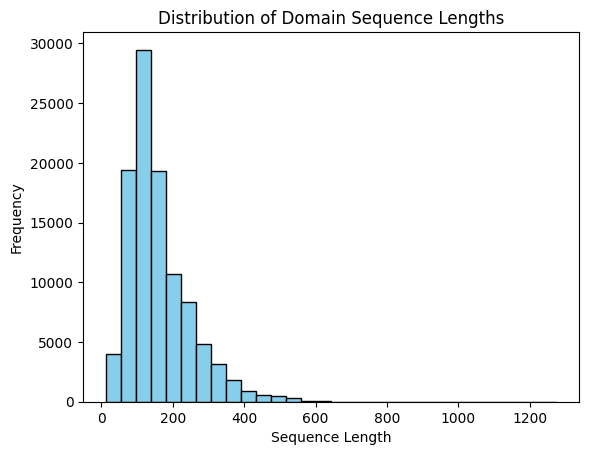

In [1]:
import matplotlib.pyplot as plt

file_path = '/Users/daxtraill/honours_project/cath-domain-boundaries-seqreschopping.txt'

sequence_lengths = []

with open(file_path, 'r') as file:
    for line in file:
        line_content = line[7:].strip()
        parts = line_content.split()
        if len(parts) > 0:
            ranges = parts[0].split(',')
            total_length = 0
            try:
                for range_part in ranges:
                    start, end = map(int, range_part.split('-'))
                    total_length += (end - start + 1)
                sequence_lengths.append(total_length)
            except ValueError:
                print(f"Skipping malformed line (invalid numbers): {line}")

plt.hist(sequence_lengths, bins=30, color='skyblue', edgecolor='black')
plt.title('Distribution of Domain Sequence Lengths')
plt.xlabel('Sequence Length')
plt.ylabel('Frequency')
plt.show()

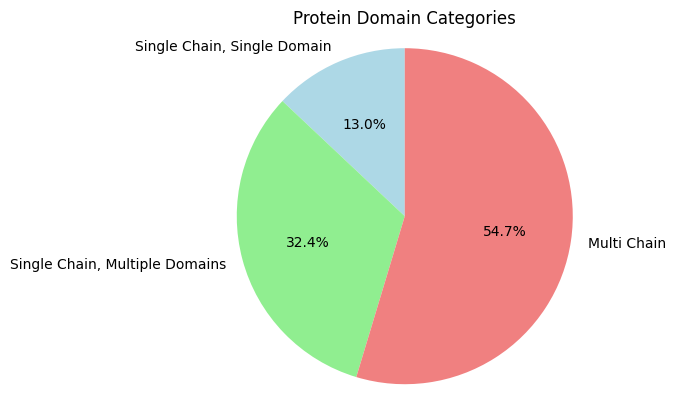

In [4]:
import matplotlib.pyplot as plt

file_path = '/Users/daxtraill/honours_project/cath-domain-boundaries-seqreschopping.txt'

single_chain_single_domain = 0
single_chain_multiple_domain = 0
multi_chain = 0

chain_id_counts = {}
pdb_id_counts = {}

with open(file_path, 'r') as file:
    for line in file:
        domain_id = line[:7]
        chain_id = domain_id[:5]
        pdb_id = domain_id[:4]

        pdb_id_counts[pdb_id] = pdb_id_counts.get(pdb_id, 0) + 1
        chain_id_counts[chain_id] = chain_id_counts.get(chain_id, 0) + 1

for pdb_id, count in pdb_id_counts.items():
    if count == 1:
        single_chain_single_domain += 1
for chain_id, count in chain_id_counts.items():
    if count > 1:
                single_chain_multiple_domain += 1
    else:
        multi_chain += 1

categories = ['Single Chain, Single Domain', 'Single Chain, Multiple Domains', 'Multi Chain']
sizes = [single_chain_single_domain, single_chain_multiple_domain, multi_chain]

fig, ax = plt.subplots()
ax.pie(sizes, labels=categories, autopct='%1.1f%%', startangle=90, colors=['lightblue', 'lightgreen', 'lightcoral'])
ax.axis('equal')

plt.title('Protein Domain Categories')
plt.show()